# Deep Learning for Monocular Depth Prediction

Yue Kuang (yk2951)



In [ ]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
import skimage.io as io
import os
import pickle
import random
import shutil
import time
import h5py

from PIL import Image
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import datasets, layers, models

In [ ]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


2022-12-04 18:09:01.099040: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-04 18:09:01.247863: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-12-04 18:09:01.249794: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


In [ ]:
# ## Mount Google Drive
# from google.colab import drive
# drive.mount('/gdrive')
# drive_root = '/gdrive/MyDrive/DLCV/project/'

In [ ]:
# helper function
def plot_depth_map(dm):
    MIN_DEPTH = 0.5
    MAX_DEPTH = min(4, np.percentile(dm, 99))
    dm = np.clip(dm, MIN_DEPTH, MAX_DEPTH)
    dm = np.log(dm)

    cmap = plt.cm.jet
    cmap.set_bad(color='black')
    plt.imshow(dm, cmap=cmap, vmax=np.log(MAX_DEPTH))

## Download Dataset and Prepare Data

In [ ]:
%cd /content/drive/My Drive/DLCV/project/

/content/drive/My Drive/DLCV/project


In [ ]:
!curl "http://horatio.cs.nyu.edu/mit/silberman/nyu_depth_v2/nyu_depth_v2_labeled.mat" --output nyu_depth_v2_labeled.mat

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 2834M  100 2834M    0     0  5179k      0  0:09:20  0:09:20 --:--:-- 3998k


In [ ]:
import skimage.io as io
import numpy as np
import h5py

# data path
path_to_depth = drive_root + 'nyu_depth_v2_labeled.mat'

# read mat file
f = h5py.File(path_to_depth)

In [ ]:
def plot_data(idx):
  # read 0-th image. original format is [3 x 640 x 480], uint8
  img = f['images'][idx]

  # reshape
  img_ = np.empty([480, 640, 3])
  img_[:,:,0] = img[0,:,:].T
  img_[:,:,1] = img[1,:,:].T
  img_[:,:,2] = img[2,:,:].T

  # imshow
  img__ = img_.astype('float32')
  io.imshow(img__/255.0)
  io.show()


  # read corresponding depth (aligned to the image, in-painted) of size [640 x 480], float64
  depth = f['depths'][idx]

  # reshape for imshow
  depth_ = np.empty([480, 640, 3])
  depth_[:,:,0] = depth[:,:].T
  depth_[:,:,1] = depth[:,:].T
  depth_[:,:,2] = depth[:,:].T

  io.imshow(depth_/4.0)
  io.show()

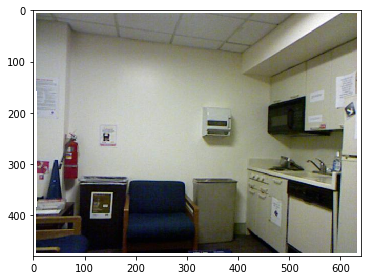

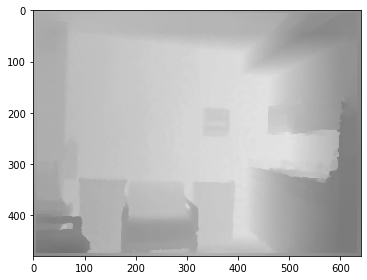

In [ ]:
plot_data(0)

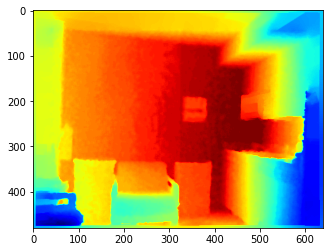

In [ ]:
plot_depth_map(f['depths'][0].T)

In [ ]:
print("There are", len(f['depths']), "images in total.")

There are 1449 images in total.


In [ ]:
import random
indexs = list(range(1449))
random.shuffle(indexs)
print(indexs)

[875, 1082, 827, 26, 1345, 591, 265, 441, 1294, 749, 1227, 1079, 1358, 854, 1095, 247, 1391, 652, 134, 428, 468, 339, 64, 1040, 675, 1132, 419, 384, 1260, 1195, 484, 400, 239, 1380, 1248, 630, 129, 856, 1404, 92, 415, 347, 375, 539, 1245, 756, 560, 753, 1425, 615, 642, 1206, 201, 385, 931, 808, 863, 1316, 334, 905, 1447, 1032, 1188, 268, 51, 1126, 923, 880, 139, 767, 1219, 1197, 82, 509, 608, 714, 1107, 21, 903, 73, 909, 30, 765, 1371, 565, 255, 517, 438, 446, 507, 991, 234, 1273, 893, 846, 730, 1246, 44, 445, 972, 121, 1179, 1222, 1025, 704, 142, 23, 74, 720, 424, 1173, 965, 221, 543, 46, 1165, 149, 737, 641, 508, 1023, 803, 1298, 85, 53, 1286, 7, 885, 497, 486, 133, 1303, 1044, 1232, 669, 456, 887, 1194, 324, 328, 37, 513, 1351, 3, 919, 877, 1193, 41, 995, 1133, 754, 1077, 829, 408, 56, 1075, 196, 382, 1343, 1178, 570, 1341, 1184, 236, 922, 987, 866, 1210, 395, 577, 1233, 1347, 572, 787, 9, 614, 800, 1287, 114, 585, 783, 1003, 1004, 207, 1444, 210, 454, 1325, 321, 688, 113, 378, 1373

In [ ]:
train_idx = indexs[:1049]
val_idx = indexs[1049:1249]
test_idx = indexs[1249:]

In [ ]:
DATA_FILE = drive_root + 'dataset.h5'
IMG_WIDTH = 480
IMG_HEIGHT = 640
IMG_CHANNELS=3

# Specify shape
train_shape = (len(train_idx), IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS)
val_shape = (len(val_idx), IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS)
test_shape = (len(test_idx), IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS)

y_train_shape = (len(train_idx), IMG_WIDTH, IMG_HEIGHT)
y_val_shape = (len(val_idx), IMG_WIDTH, IMG_HEIGHT)
y_test_shape = (len(test_idx), IMG_WIDTH, IMG_HEIGHT)

# Create hdf5 file
hdf5_file = h5py.File(DATA_FILE, mode='w')
hdf5_file.create_dataset('x_train', train_shape, np.float32, compression="gzip")
hdf5_file.create_dataset('x_val', val_shape, np.float32, compression="gzip")
hdf5_file.create_dataset('x_test', test_shape, np.float32, compression="gzip")
hdf5_file.create_dataset('y_train', y_train_shape, np.float32,
                         compression="gzip")
hdf5_file.create_dataset('y_val', y_val_shape, np.float32, compression="gzip")
hdf5_file.create_dataset('y_test', y_test_shape, np.float32, compression="gzip")

<HDF5 dataset "y_test": shape (200, 480, 640), type "<f4">

In [ ]:
for i in range(len(train_idx)):
  index = train_idx[i]
  img = f['images'][index]
  img_ = np.empty([480, 640, 3])
  img_[:,:,0] = img[0,:,:].T
  img_[:,:,1] = img[1,:,:].T
  img_[:,:,2] = img[2,:,:].T
  img__ = img_.astype('float32')
  img__ /= 255.0

  hdf5_file['x_train'][i, ...] = img__

  depth = f['depths'][index]
  hdf5_file['y_train'][i, ...] = depth.T / 4.0

In [ ]:
for i in range(len(val_idx)):
  index = val_idx[i]
  img = f['images'][index]
  img_ = np.empty([480, 640, 3])
  img_[:,:,0] = img[0,:,:].T
  img_[:,:,1] = img[1,:,:].T
  img_[:,:,2] = img[2,:,:].T
  img__ = img_.astype('float32')
  img__ /= 255.0

  hdf5_file['x_val'][i, ...] = img__

  depth = f['depths'][index]
  hdf5_file['y_val'][i, ...] = depth.T / 4.0

In [ ]:
for i in range(len(test_idx)):
  index = test_idx[i]
  img = f['images'][index]
  img_ = np.empty([480, 640, 3])
  img_[:,:,0] = img[0,:,:].T
  img_[:,:,1] = img[1,:,:].T
  img_[:,:,2] = img[2,:,:].T
  img__ = img_.astype('float32')
  img__ /= 255.0

  hdf5_file['x_test'][i, ...] = img__

  depth = f['depths'][index]
  hdf5_file['y_test'][i, ...] = depth.T / 4.0

In [ ]:
hdf5_file.close()

Now we have created the dataset we are going to use for the project, we **uploaded it to our GCP bucket** so that we can use it in the future by directly downloading it.

## Data Preprocessing

In [ ]:
def download_if_missing(url, target, extract=True):
  if os.path.exists(target):
    return target
  return tf.keras.utils.get_file(target, origin=url, extract=extract)

DATA_FILE = "dataset.h5"
DATASET_URL = "https://storage.googleapis.com/hw3_vqa/dataset.h5" # replace with your own dataset link
download_if_missing(DATASET_URL,
                    DATA_FILE,
                    extract=False)

2651404418/2651404418 [==============================] - 46s 0us/step


'/root/.keras/datasets/dataset.h5'

In [ ]:
DATA_FILE = '/home/jupyter/.keras/datasets/dataset.h5' # the file location of our dataset

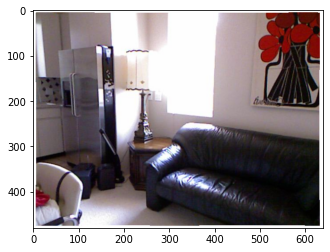

In [ ]:
# Visualize dataset train sample
hdf5_file = h5py.File(DATA_FILE, 'r')
train_count = hdf5_file['x_train'].shape[0]

index = random.randint(0, train_count)
image = hdf5_file['x_train'][index]
depth = hdf5_file['y_train'][index]
plt.imshow(image)
plt.show()

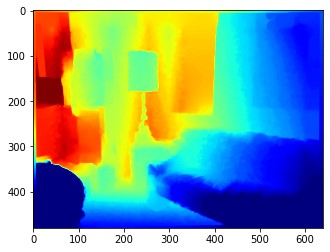

In [ ]:
plot_depth_map(depth)

In [ ]:

import math
def HDF5ImageGenerator(hdf5_x, hdf5_y, data_generator, batch_size, seed):
  sample_count  = hdf5_x.shape[0]
  count         = 0

  while True:
    batch_index = 0
    batches_list = list(range(int(math.ceil(float(sample_count) / batch_size))))
    random.shuffle(batches_list)

    while batch_index < len(batches_list):
      batch_number = batches_list[batch_index]
      start        = batch_number * batch_size
      end          = min(start + batch_size, sample_count)

      # Load data from disk
      x = hdf5_x[start: end]
      y = hdf5_y[start: end]

      # generator = data_generator.flow(x,y,batch_size=batch_size, seed = seed + count)
      # x, y = next(generator)

      batch_index += 1
      count       += 1

      yield x, y

In [ ]:
x_train = hdf5_file['x_train']
x_val = hdf5_file['x_val']
x_test = hdf5_file['x_test']

y_train = hdf5_file['y_train']
y_val = hdf5_file['y_val']
y_test = hdf5_file['y_test']

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
data_generator = ImageDataGenerator()

In [ ]:
batch_size = 4
seed       = 0

train_generator = HDF5ImageGenerator(x_train, y_train, data_generator, batch_size, seed)
val_generator = HDF5ImageGenerator(x_val, y_val, data_generator, batch_size, seed)
test_generator  = HDF5ImageGenerator(x_test, y_test, data_generator, batch_size, seed)

In [ ]:
x, y = next(train_generator)
print(x.shape)
print(y.shape)

(4, 480, 640, 3)
(4, 480, 640)


## Convolutional Autoencoder

### define model

In [ ]:
encoder = models.Sequential()

encoder.add(layers.Conv2D(64, 11, strides=1, padding='same', activation='relu', input_shape=(480, 640, 3)))
encoder.add(layers.BatchNormalization())
encoder.add(layers.MaxPooling2D(2))

encoder.add(layers.Conv2D(128, 5, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
encoder.add(layers.MaxPooling2D(2))

encoder.add(layers.Conv2D(256, 5, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
encoder.add(layers.MaxPooling2D(2))

encoder.add(layers.Conv2D(512, 3, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
encoder.add(layers.MaxPooling2D(2))
encoder.add(layers.Conv2D(512, 3, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
encoder.add(layers.Conv2D(512, 3, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
encoder.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 480, 640, 64)      23296     
                                                                 
 batch_normalization_11 (Bat  (None, 480, 640, 64)     256       
 chNormalization)                                                
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 240, 320, 64)     0         
 2D)                                                             
                                                                 
 conv2d_13 (Conv2D)          (None, 240, 320, 128)     204928    
                                                                 
 batch_normalization_12 (Bat  (None, 240, 320, 128)    512       
 chNormalization)                                                
                                                      

In [ ]:
decoder = models.Sequential()

decoder.add(layers.Conv2D(512, 3, strides=1, padding='same', activation='relu', input_shape=encoder.output.shape[1:]))
encoder.add(layers.BatchNormalization())
# decoder.add(layers.Conv2D(128, 3, strides=1, padding='same', activation='relu'))
decoder.add(layers.UpSampling2D(2))

decoder.add(layers.Conv2D(256, 3, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
decoder.add(layers.UpSampling2D(2))

decoder.add(layers.Conv2D(128, 3, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
decoder.add(layers.UpSampling2D(2))

decoder.add(layers.Conv2D(64, 3, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
decoder.add(layers.UpSampling2D(2))

decoder.add(layers.Conv2D(16, 3, strides=1, padding='same', activation='relu'))
encoder.add(layers.BatchNormalization())
decoder.add(layers.Conv2D(1, 1, strides=1, padding='same', activation='tanh'))
decoder.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 30, 40, 512)       2359808   
                                                                 
 up_sampling2d_4 (UpSampling  (None, 60, 80, 512)      0         
 2D)                                                             
                                                                 
 conv2d_19 (Conv2D)          (None, 60, 80, 256)       1179904   
                                                                 
 up_sampling2d_5 (UpSampling  (None, 120, 160, 256)    0         
 2D)                                                             
                                                                 
 conv2d_20 (Conv2D)          (None, 120, 160, 128)     295040    
                                                                 
 up_sampling2d_6 (UpSampling  (None, 240, 320, 128)   

### train the model

In [ ]:
import keras.backend as K
def depth_loss_function(y_true, y_pred, theta=0.2, maxDepthVal=3.5):
  y_pred = tf.reshape(y_pred, [-1, 480, 640, 1])
  y_true= tf.reshape(y_true, [-1, 480, 640, 1])*4.0
  # print(y_true) 
  # Point-wise depth
  l_depth = K.mean(K.abs(y_pred - y_true), axis=-1)

  # Edges
  dy_true, dx_true = tf.image.image_gradients(y_true)
  dy_pred, dx_pred = tf.image.image_gradients(y_pred)
  l_edges = K.mean(K.abs(dy_pred - dy_true) + K.abs(dx_pred - dx_true), axis=-1)

  # Structural similarity (SSIM) index
  l_ssim = K.clip((1 - tf.image.ssim(y_true, y_pred, maxDepthVal)) * 0.5, 0, 1)

  # Weights
  w1 = 1.0
  w2 = 1.5
  w3 = theta

  return (w1 * l_ssim) + (w2 * K.mean(l_edges)) + (w3 * K.mean(l_depth))

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, amsgrad=True)
conv_autoencoder = tf.keras.Model(inputs=encoder.input, outputs=decoder(encoder.outputs)*1.75+2.25)
conv_autoencoder.compile(optimizer=optimizer, loss=depth_loss_function)

In [ ]:
epochs = 100
history = conv_autoencoder.fit(train_generator, validation_data=val_generator, steps_per_epoch=len(x_train) // batch_size, epochs=epochs, validation_steps=20)

Epoch 1/100
262/262 [==============================] - 197s 745ms/step - loss: 0.3069 - val_loss: 0.3101
Epoch 2/100
262/262 [==============================] - 195s 747ms/step - loss: 0.2964 - val_loss: 0.2818
Epoch 3/100
262/262 [==============================] - 195s 744ms/step - loss: 0.2933 - val_loss: 0.2971
Epoch 4/100
262/262 [==============================] - 194s 742ms/step - loss: 0.2885 - val_loss: 0.2737
Epoch 5/100
262/262 [==============================] - 195s 744ms/step - loss: 0.2844 - val_loss: 0.2966
Epoch 6/100
262/262 [==============================] - 195s 745ms/step - loss: 0.2871 - val_loss: 0.2844
Epoch 7/100
262/262 [==============================] - 194s 743ms/step - loss: 0.2834 - val_loss: 0.2785
Epoch 8/100
262/262 [==============================] - 196s 747ms/step - loss: 0.2841 - val_loss: 0.2764
Epoch 9/100
262/262 [==============================] - 192s 736ms/step - loss: 0.2788 - val_loss: 0.3008
Epoch 10/100
262/262 [==============================] -

In [ ]:
conv_autoencoder.save_weights("cae_100.h5")

### evaluation

In [ ]:
def compute_errors(gt, pred):
    thresh = np.maximum((gt / pred), (pred / gt))
    a1 = (thresh < 1.25   ).mean()
    a2 = (thresh < 1.25 ** 2).mean()
    a3 = (thresh < 1.25 ** 3).mean()
    abs_rel = np.mean(np.abs(gt - pred) / gt)
    rmse = (gt - pred) ** 2
    rmse = np.sqrt(rmse.mean())
    log_10 = (np.abs(np.log10(gt)-np.log10(pred))).mean()
    return a1, a2, a3, abs_rel, rmse, log_10

pred = conv_autoencoder.predict(np.array(x_test)).squeeze()
print(compute_errors(np.array(y_test)*4.0, pred))

7/7 [==============================] - 33s 2s/step
(0.5010107096354167, 0.7869895182291666, 0.923257470703125, 0.299435, 1.106508, 0.12287349)


### demo

In [ ]:
x, y = next(test_generator)
print(x.shape)
print(y.shape)

(4, 480, 640, 3)
(4, 480, 640)


1/1 [==============================] - 0s 29ms/step


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("jet").copy()
  """


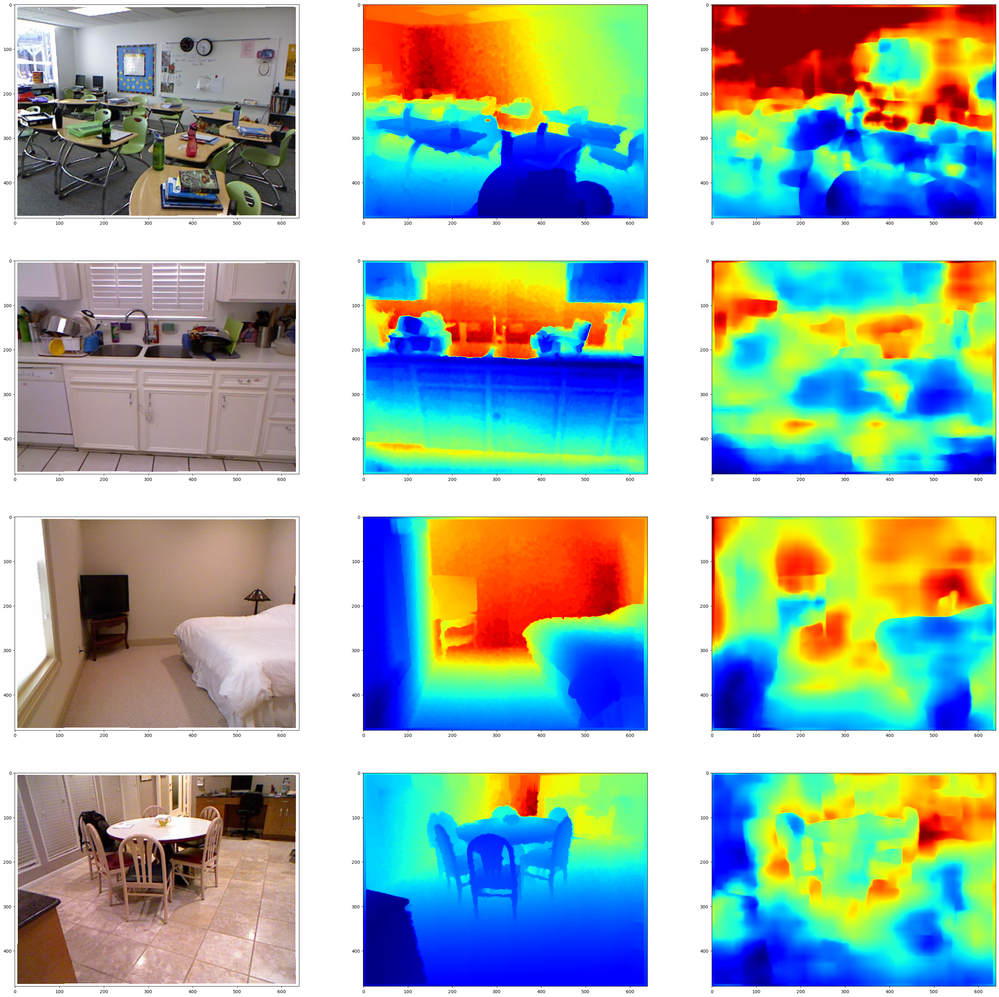

In [ ]:
def visualize_depth_map(x, y, model=None):
    input = x
    target = y
    cmap = plt.cm.jet
    cmap.set_bad(color="black")

    num_samples = len(x)
    pred = model.predict(input)
    fig, ax = plt.subplots(num_samples, 3, figsize=(40, 10*num_samples))
    for i in range(num_samples):
        ax[i, 0].imshow((input[i].squeeze()))
        ax[i, 1].imshow((target[i].squeeze()*4), cmap=cmap)
        ax[i, 2].imshow((pred[i].squeeze()), cmap=cmap)

visualize_depth_map(x, y, conv_autoencoder)

## U-net

### define model

In [ ]:
f = [32, 64, 128, 256, 512]
def downblock(tensor, i):
  temp = layers.Conv2D(f[i], (3,3), 1, "same")(tensor)
  output = layers.BatchNormalization()(temp)
  output = layers.LeakyReLU(alpha=0.2)(output)
  output = layers.Conv2D(f[i], (3,3), 1, "same")(output)
  output = layers.BatchNormalization()(output)
  output = layers.LeakyReLU(alpha=0.2)(output)
  p = output + temp
  output = layers.MaxPool2D((2, 2), (2, 2), padding="same")(p)
  return output, p

def upblock(tensor, i, skip):
  output = layers.UpSampling2D((2, 2))(tensor)
  print(tensor.shape, output.shape, skip.shape)
  concat = layers.Concatenate()([output, skip])
  output = layers.Conv2D(f[i], (3,3), 1, "same")(output)
  output = layers.BatchNormalization()(output)
  output = layers.LeakyReLU(alpha=0.2)(output)
  output = layers.Conv2D(f[i], (3,3), 1, "same")(output)
  output = layers.BatchNormalization()(output)
  output = layers.LeakyReLU(alpha=0.2)(output)
  return output

In [ ]:
from tensorflow.keras import Model
image_input = tf.keras.layers.Input((480, 640, 3))
p = []
output = image_input
for i in range(4):
  output, p_ = downblock(output, i)
  p.append(p_)

output = layers.Conv2D(f[4], (3,3), 1, "same")(output)
output = layers.LeakyReLU(alpha=0.2)(output)
output = layers.Conv2D(f[4], (3,3), 1, "same")(output)
output = layers.LeakyReLU(alpha=0.2)(output)

for i in range(3, -1, -1):
  output = upblock(output, i, p[i])

output = layers.Conv2D(1, (1, 1), padding="same", activation="tanh")(output)
output = output * 1.75 + 2.25

model = Model(inputs=image_input, outputs=output)

(None, 30, 40, 512) (None, 60, 80, 512) (None, 60, 80, 256)
(None, 60, 80, 256) (None, 120, 160, 256) (None, 120, 160, 128)
(None, 120, 160, 128) (None, 240, 320, 128) (None, 240, 320, 64)
(None, 240, 320, 64) (None, 480, 640, 64) (None, 480, 640, 32)


In [ ]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 480, 640, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_24 (Conv2D)             (None, 480, 640, 32  896         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_22 (BatchN  (None, 480, 640, 32  128        ['conv2d_24[0][0]']              
 ormalization)                  )                                                           

### visualize model architecture

In [ ]:
import visualkeras

In [ ]:
!pip install visualkeras

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 992 kB 4.9 MB/s 


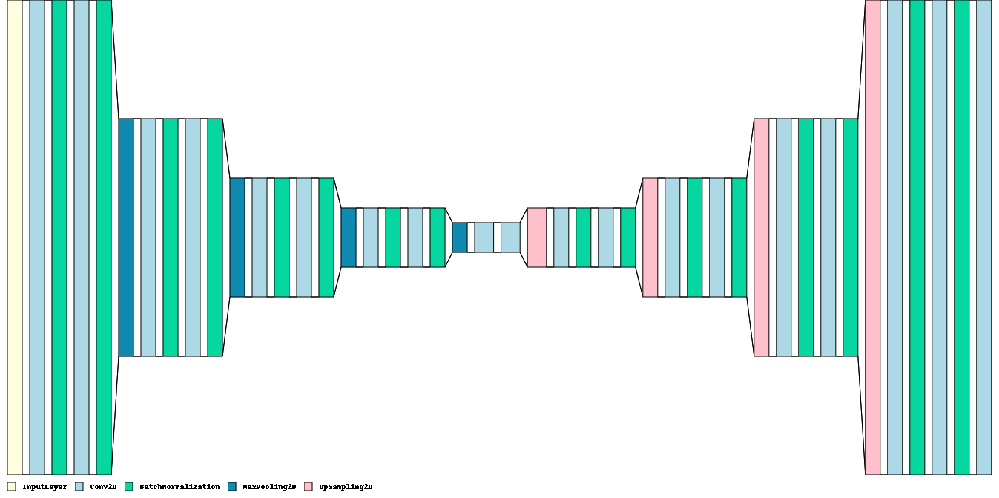

In [ ]:
from collections import defaultdict
color_map = defaultdict(dict)
color_map[layers.InputLayer]['fill'] = 'lightyellow'
color_map[layers.Conv2D]['fill'] = 'lightblue'
color_map[layers.UpSampling2D]['fill'] = 'pink'
visualkeras.layered_view(model, to_file='output1.png', legend=True, draw_volume=False, scale_xy = 1, 
                         type_ignore=[ layers.LeakyReLU],
                         index_ignore=[7, 15, 23, 31, 66, 67], color_map = color_map)

### train the model

In [ ]:
import keras.backend as K
def depth_loss_function(y_true, y_pred, theta=0.2, maxDepthVal=3.5):
  y_pred = tf.reshape(y_pred, [-1, 480, 640, 1])
  y_true= tf.reshape(y_true, [-1, 480, 640, 1])*4.0
  # print(y_true) 
  # Point-wise depth
  l_depth = K.mean(K.abs(y_pred - y_true), axis=-1)

  # Edges
  dy_true, dx_true = tf.image.image_gradients(y_true)
  dy_pred, dx_pred = tf.image.image_gradients(y_pred)
  l_edges = K.mean(K.abs(dy_pred - dy_true) + K.abs(dx_pred - dx_true), axis=-1)

  # Structural similarity (SSIM) index
  l_ssim = K.clip((1 - tf.image.ssim(y_true, y_pred, maxDepthVal)) * 0.5, 0, 1)

  # Weights
  w1 = 1.0
  w2 = 1.5
  w3 = theta

  return (w1 * l_ssim) + (w2 * K.mean(l_edges)) + (w3 * K.mean(l_depth))

In [ ]:
optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0005,
    amsgrad=True,
)

model.compile(optimizer, loss=depth_loss_function)

In [ ]:
epochs = 60
model.fit(train_generator, validation_data=val_generator, steps_per_epoch=len(x_train) // batch_size, epochs=epochs, validation_steps=20)

Epoch 1/60
262/262 [==============================] - 200s 753ms/step - loss: 0.3247 - val_loss: 0.3072
Epoch 2/60
262/262 [==============================] - 191s 732ms/step - loss: 0.3060 - val_loss: 0.2927
Epoch 3/60
262/262 [==============================] - 191s 728ms/step - loss: 0.2972 - val_loss: 0.3187
Epoch 4/60
262/262 [==============================] - 193s 737ms/step - loss: 0.2880 - val_loss: 0.2941
Epoch 5/60
262/262 [==============================] - 194s 742ms/step - loss: 0.2926 - val_loss: 0.2668
Epoch 6/60
262/262 [==============================] - 189s 724ms/step - loss: 0.2898 - val_loss: 0.3067
Epoch 7/60
262/262 [==============================] - 195s 747ms/step - loss: 0.2845 - val_loss: 0.2935
Epoch 8/60
262/262 [==============================] - 195s 745ms/step - loss: 0.2842 - val_loss: 0.2753
Epoch 9/60
262/262 [==============================] - 194s 741ms/step - loss: 0.2842 - val_loss: 0.2776
Epoch 10/60
262/262 [==============================] - 190s 725m

In [ ]:
model.save_weights("unet60.h5")

### evaluation

In [ ]:
def compute_errors(gt, pred):
    thresh = np.maximum((gt / pred), (pred / gt))
    a1 = (thresh < 1.25   ).mean()
    a2 = (thresh < 1.25 ** 2).mean()
    a3 = (thresh < 1.25 ** 3).mean()
    abs_rel = np.mean(np.abs(gt - pred) / gt)
    rmse = (gt - pred) ** 2
    rmse = np.sqrt(rmse.mean())
    log_10 = (np.abs(np.log10(gt)-np.log10(pred))).mean()
    return a1, a2, a3, abs_rel, rmse, log_10

pred = model.predict(np.array(x_test)).squeeze()

print(compute_errors(np.array(y_test)*4.0, pred))

7/7 [==============================] - 6s 1s/step
(0.4777571126302083, 0.767173583984375, 0.9110503255208333, 0.33765262, 1.1231756, 0.12920654)


### demo

In [ ]:
x, y = next(test_generator)
print(x.shape)
print(y.shape)

(4, 480, 640, 3)
(4, 480, 640)


In [ ]:
def visualize_depth_map(x, y, model=None):
    input = x
    target = y
    cmap = plt.cm.jet
    cmap.set_bad(color="black")

    num_samples = len(x)
    pred = model.predict(input)
    fig, ax = plt.subplots(num_samples, 3, figsize=(40, 10*num_samples))
    for i in range(num_samples):
        ax[i, 0].imshow((input[i].squeeze()))
        ax[i, 1].imshow((target[i].squeeze()*4), cmap=cmap)
        ax[i, 2].imshow((pred[i].squeeze()), cmap=cmap)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("jet").copy()
  """


1/1 [==============================] - 0s 303ms/step


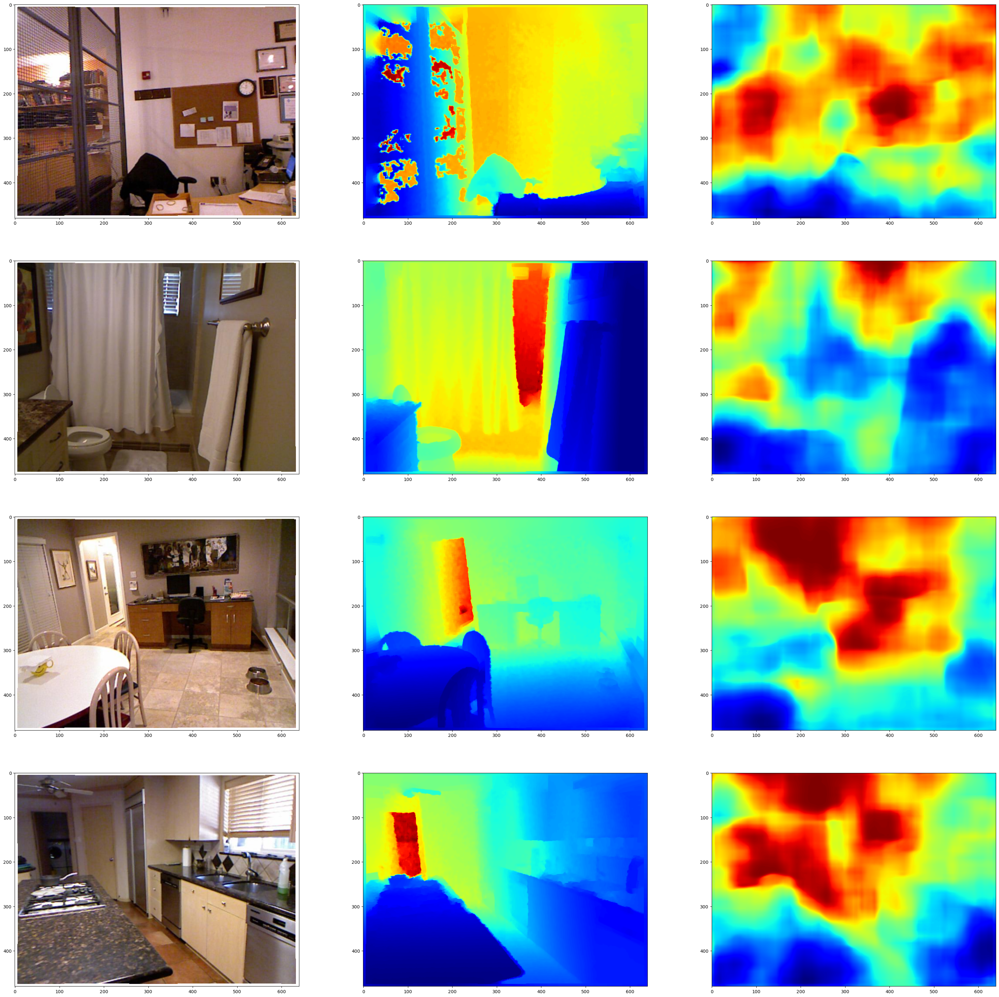

In [ ]:
visualize_depth_map(x, y, model)

## Xception + Decoder

### define model

In [ ]:
base_model = tf.keras.applications.xception.Xception(input_shape=(480, 640, 3), include_top=False)

In [ ]:
for layer in base_model.layers: 
  layer.trainable = False

In [ ]:
base_model_output_shape = base_model.layers[-1].output.shape
base_model_output_shape

TensorShape([None, 15, 20, 2048])

In [ ]:
# decoder part
concat_layers = ['conv2d_39', 'conv2d_38'] # depends on base model layer names
f = [1024, 512, 256, 128, 64, 32]

def upblock(tensor, i, skip=None):
  output = layers.UpSampling2D((2, 2))(tensor)
  if skip is not None:
    concat = layers.Concatenate()([output, skip]) # skip connection
    output = layers.Conv2D(f[i], (3,3), 1, "same")(concat)
  else:
    output = layers.Conv2D(f[i], (3,3), 1, "same")(output)
  output = layers.BatchNormalization()(output)
  output = layers.LeakyReLU(alpha=0.2)(output)
  output = layers.Conv2D(f[i], (3,3), 1, "same")(output)
  output = layers.BatchNormalization()(output)
  output = layers.LeakyReLU(alpha=0.2)(output)
  return output

In [ ]:
from tensorflow.keras import Model

output = layers.Conv2D(f[0], kernel_size=1, padding='same', input_shape=base_model_output_shape)(base_model.output)

for i in range(5):
  if i < 2:
    output = upblock(output, i+1, base_model.get_layer(concat_layers[i]).output)
  else:
    output = upblock(output, i+1)

output = layers.Conv2D(filters=1, kernel_size=3, strides=1, padding='same', activation="tanh")(output)

# output = layers.Conv2D(1, (1, 1), padding="same", activation="tanh")(output)
output = output * 1.75 + 2.25

model = Model(inputs=base_model.input, outputs=output)

In [ ]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 480, 640, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 239, 319, 32  864         ['input_4[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 239, 319, 32  128        ['block1_conv1[0][0]']           
 ation)                         )                                                           

### train the model

In [ ]:
import keras.backend as K
def depth_loss_function(y_true, y_pred, theta=0.2, maxDepthVal=3.5):
  y_pred = tf.reshape(y_pred, [-1, 480, 640, 1])
  y_true= tf.reshape(y_true, [-1, 480, 640, 1])*4.0
  # print(y_true) 
  # Point-wise depth
  l_depth = K.mean(K.abs(y_pred - y_true), axis=-1)

  # Edges
  dy_true, dx_true = tf.image.image_gradients(y_true)
  dy_pred, dx_pred = tf.image.image_gradients(y_pred)
  l_edges = K.mean(K.abs(dy_pred - dy_true) + K.abs(dx_pred - dx_true), axis=-1)

  # Structural similarity (SSIM) index
  l_ssim = K.clip((1 - tf.image.ssim(y_true, y_pred, maxDepthVal)) * 0.5, 0, 1)

  # Weights
  w1 = 1.0
  w2 = 1.5
  w3 = theta

  return (w1 * l_ssim) + (w2 * K.mean(l_edges)) + (w3 * K.mean(l_depth))

In [ ]:
optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0005,
    amsgrad=True,
)

model.compile(optimizer, loss=depth_loss_function)

In [ ]:
epochs = 20
history = model.fit(train_generator, validation_data=val_generator, steps_per_epoch=len(x_train) // batch_size, epochs=epochs, validation_steps=20)

Epoch 1/20
262/262 [==============================] - 215s 777ms/step - loss: 0.3033 - val_loss: 0.2642
Epoch 2/20
262/262 [==============================] - 205s 785ms/step - loss: 0.2522 - val_loss: 0.2573
Epoch 3/20
262/262 [==============================] - 201s 767ms/step - loss: 0.2473 - val_loss: 0.2473
Epoch 4/20
262/262 [==============================] - 199s 761ms/step - loss: 0.2405 - val_loss: 0.2302
Epoch 5/20
262/262 [==============================] - 204s 781ms/step - loss: 0.2335 - val_loss: 0.2287
Epoch 6/20
262/262 [==============================] - 199s 760ms/step - loss: 0.2353 - val_loss: 0.2045
Epoch 7/20
262/262 [==============================] - 205s 783ms/step - loss: 0.2278 - val_loss: 0.2488
Epoch 8/20
262/262 [==============================] - 203s 775ms/step - loss: 0.2288 - val_loss: 0.2293
Epoch 9/20
262/262 [==============================] - 201s 768ms/step - loss: 0.2201 - val_loss: 0.2454
Epoch 10/20
262/262 [==============================] - 203s 776m

In [ ]:
model.save_weights("xception+decoder+skip_20.h5")

In [ ]:
def compute_errors(gt, pred):
    thresh = np.maximum((gt / pred), (pred / gt))
    a1 = (thresh < 1.25   ).mean()
    a2 = (thresh < 1.25 ** 2).mean()
    a3 = (thresh < 1.25 ** 3).mean()
    abs_rel = np.mean(np.abs(gt - pred) / gt)
    rmse = (gt - pred) ** 2
    rmse = np.sqrt(rmse.mean())
    log_10 = (np.abs(np.log10(gt)-np.log10(pred))).mean()
    return a1, a2, a3, abs_rel, rmse, log_10

pred = model.predict(np.array(x_test)).squeeze()

print(compute_errors(np.array(y_test)*4.0, pred))

7/7 [==============================] - 11s 2s/step
(0.5645835774739584, 0.8476621419270833, 0.9511551920572917, 0.2633217, 0.9842685, 0.105841435)


(4, 480, 640, 3)
(4, 480, 640)
1/1 [==============================] - 0s 36ms/step


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("jet").copy()
  if __name__ == "__main__":


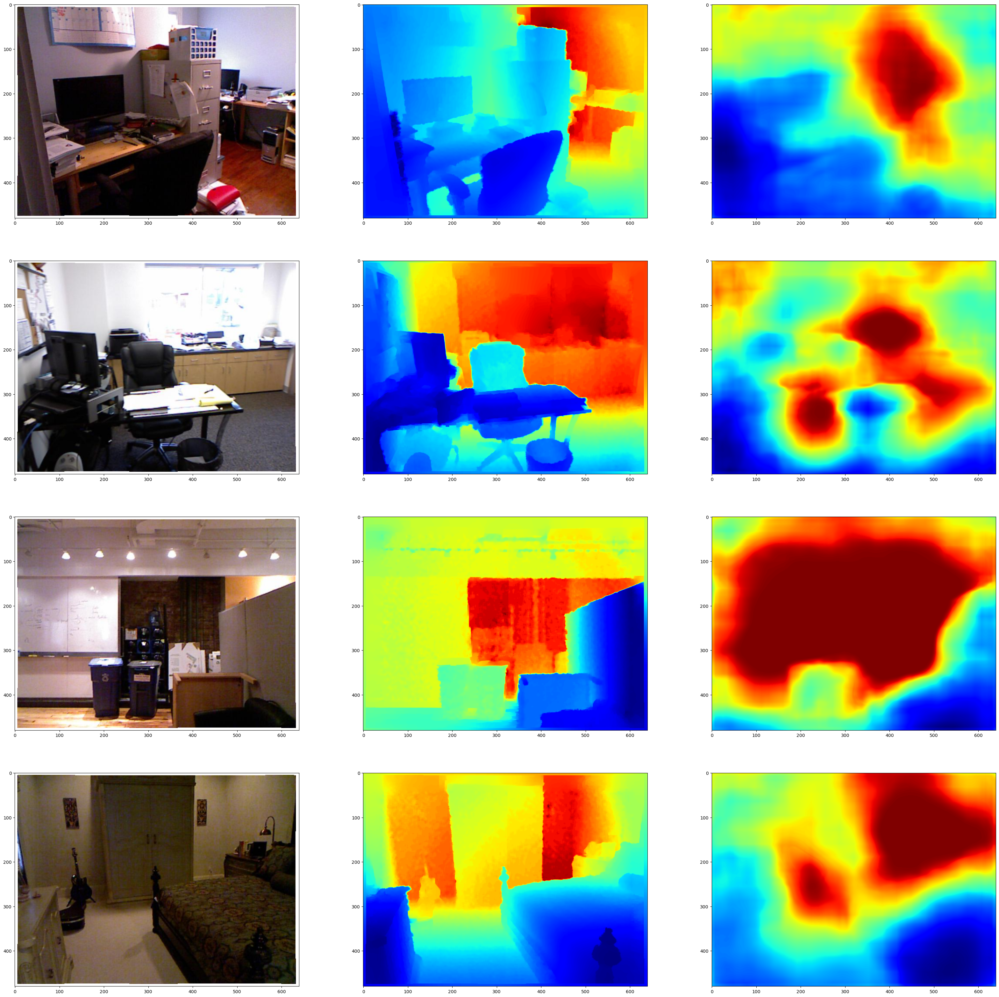

In [ ]:
x, y = next(test_generator)
print(x.shape)
print(y.shape)

def visualize_depth_map(x, y, model=None):
    input = x
    target = y
    cmap = plt.cm.jet
    cmap.set_bad(color="black")

    num_samples = len(x)
    pred = model.predict(input)
    fig, ax = plt.subplots(num_samples, 3, figsize=(40, 10*num_samples))
    for i in range(num_samples):
        ax[i, 0].imshow((input[i].squeeze()))
        ax[i, 1].imshow((target[i].squeeze()*4), cmap=cmap)
        ax[i, 2].imshow((pred[i].squeeze()), cmap=cmap)

visualize_depth_map(x, y, model)

In [ ]:
# set all layers as trainable and perform finetuning
for layer in model.layers:
  layer.trainable = True

optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0001,
    amsgrad=True,
)

model.compile(optimizer, loss=depth_loss_function)

In [ ]:
epochs = 15
history = model.fit(train_generator, validation_data=val_generator, steps_per_epoch=len(x_train) // batch_size, epochs=epochs, validation_steps=20)

Epoch 1/15
262/262 [==============================] - 270s 1s/step - loss: 0.2248 - val_loss: 0.2074
Epoch 2/15
262/262 [==============================] - 259s 990ms/step - loss: 0.1972 - val_loss: 0.2165
Epoch 3/15
262/262 [==============================] - 260s 994ms/step - loss: 0.1714 - val_loss: 0.1951
Epoch 4/15
262/262 [==============================] - 260s 994ms/step - loss: 0.1663 - val_loss: 0.1986
Epoch 5/15
262/262 [==============================] - 260s 991ms/step - loss: 0.1578 - val_loss: 0.2001
Epoch 6/15
262/262 [==============================] - 260s 991ms/step - loss: 0.1485 - val_loss: 0.1931
Epoch 7/15
262/262 [==============================] - 259s 989ms/step - loss: 0.1538 - val_loss: 0.1945
Epoch 8/15
262/262 [==============================] - 262s 1s/step - loss: 0.1462 - val_loss: 0.1957
Epoch 9/15
262/262 [==============================] - 259s 989ms/step - loss: 0.1417 - val_loss: 0.1930
Epoch 10/15
262/262 [==============================] - 261s 997ms/step

In [ ]:
# train one more epoch
epochs = 1
model.fit(train_generator, validation_data=val_generator, steps_per_epoch=len(x_train) // batch_size, epochs=epochs, validation_steps=20)

262/262 [==============================] - 263s 1s/step - loss: 0.1302 - val_loss: 0.1897


In [ ]:
# train one more epoch
epochs = 1
model.fit(train_generator, validation_data=val_generator, steps_per_epoch=len(x_train) // batch_size, epochs=epochs, validation_steps=20)

262/262 [==============================] - 260s 991ms/step - loss: 0.1303 - val_loss: 0.1874


In [ ]:
model.save_weights("xception+decoder+skip_20f17.h5")

### evaluation

In [ ]:
def compute_errors(gt, pred):
    thresh = np.maximum((gt / pred), (pred / gt))
    a1 = (thresh < 1.25   ).mean()
    a2 = (thresh < 1.25 ** 2).mean()
    a3 = (thresh < 1.25 ** 3).mean()
    abs_rel = np.mean(np.abs(gt - pred) / gt)
    rmse = (gt - pred) ** 2
    rmse = np.sqrt(rmse.mean())
    log_10 = (np.abs(np.log10(gt)-np.log10(pred))).mean()
    return a1, a2, a3, abs_rel, rmse, log_10

In [ ]:
pred = model.predict(np.array(x_test)).squeeze()
print(compute_errors(np.array(y_test)*4.0, pred))

7/7 [==============================] - 10s 2s/step
(0.6737135579427084, 0.898109912109375, 0.9751914713541666, 0.20279352, 0.8700552, 0.08468108)


### demo

(4, 480, 640, 3)
(4, 480, 640)
1/1 [==============================] - 0s 37ms/step


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("jet").copy()
  if __name__ == "__main__":


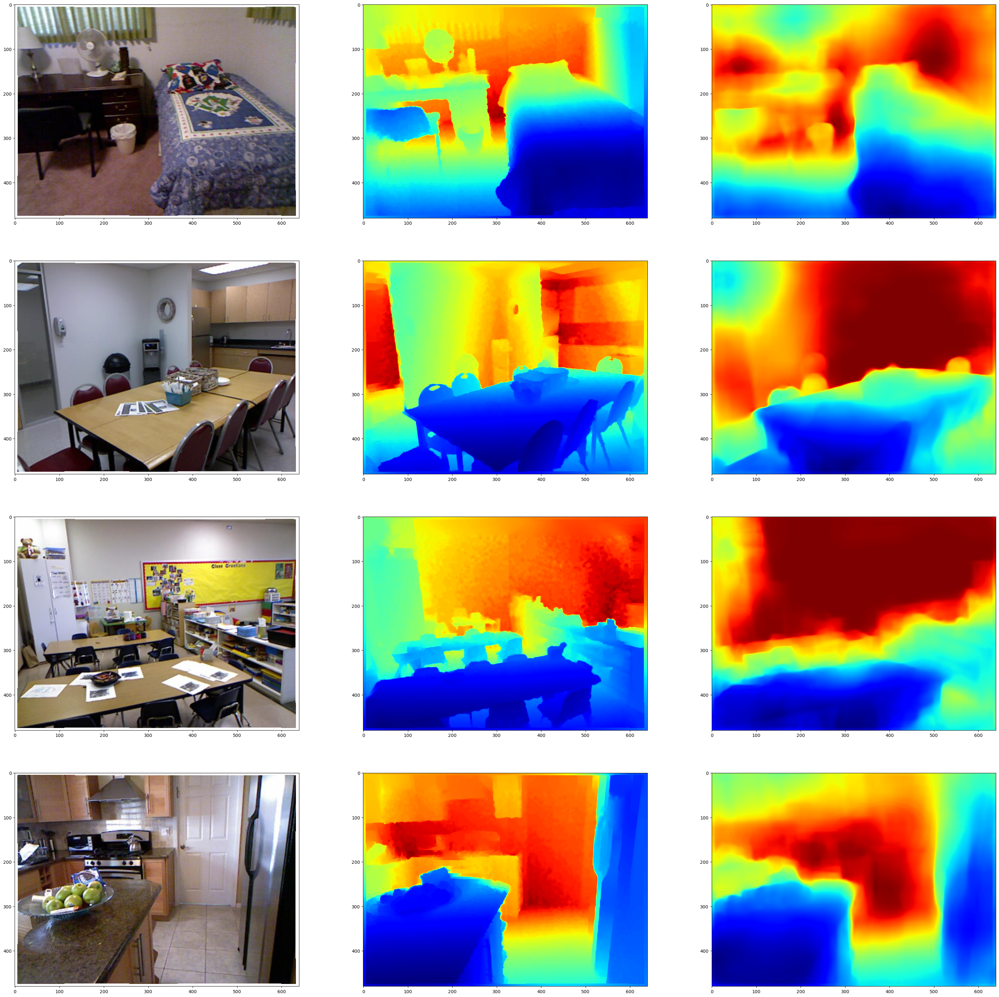

In [ ]:
x, y = next(test_generator)
print(x.shape)
print(y.shape)

visualize_depth_map(x, y, model)

## Dense + Decoder

### define model

In [ ]:
base_model = tf.keras.applications.densenet.DenseNet169(input_shape=(480, 640, 3), include_top=False)

51877672/51877672 [==============================] - 1s 0us/step


In [ ]:
for layer in base_model.layers: 
  layer.trainable = False

In [ ]:
base_model_output_shape = base_model.layers[-1].output.shape

In [ ]:
base_model_output_shape

TensorShape([None, 15, 20, 1664])

In [ ]:
# decoder part
concat_layers = ['pool3_pool','pool2_pool', "pool1", "conv1/relu", "input_1"] # depends on base model layer names
f = [832, 416, 208, 104, 52, 26]

def upblock(tensor, i, skip):
  output = layers.UpSampling2D((2, 2))(tensor)
  concat = layers.Concatenate()([output, skip]) # skip connection
  output = layers.Conv2D(f[i], (3,3), 1, "same")(concat)
  output = layers.BatchNormalization()(output)
  output = layers.LeakyReLU(alpha=0.2)(output)
  output = layers.Conv2D(f[i], (3,3), 1, "same")(output)
  output = layers.BatchNormalization()(output)
  output = layers.LeakyReLU(alpha=0.2)(output)
  return output

In [ ]:
from tensorflow.keras import Model

output = layers.Conv2D(f[0], kernel_size=1, padding='same', input_shape=base_model_output_shape)(base_model.output)

for i in range(5):
  output = upblock(output, i+1, base_model.get_layer(concat_layers[i]).output)

output = layers.Conv2D(filters=1, kernel_size=3, strides=1, padding='same', activation="tanh")(output)

output = output * 1.75 + 2.25

model = Model(inputs=base_model.input, outputs=output)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 480, 640, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 486, 646, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 240, 320, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                              

### train the model

In [ ]:
import keras.backend as K
def depth_loss_function(y_true, y_pred, theta=0.2, maxDepthVal=3.5):
  y_pred = tf.reshape(y_pred, [-1, 480, 640, 1])
  y_true= tf.reshape(y_true, [-1, 480, 640, 1])*4.0
  # print(y_true) 
  # Point-wise depth
  l_depth = K.mean(K.abs(y_pred - y_true), axis=-1)

  # Edges
  dy_true, dx_true = tf.image.image_gradients(y_true)
  dy_pred, dx_pred = tf.image.image_gradients(y_pred)
  l_edges = K.mean(K.abs(dy_pred - dy_true) + K.abs(dx_pred - dx_true), axis=-1)

  # Structural similarity (SSIM) index
  l_ssim = K.clip((1 - tf.image.ssim(y_true, y_pred, maxDepthVal)) * 0.5, 0, 1)

  # Weights
  w1 = 1.0
  w2 = 1.5
  w3 = theta

  return (w1 * l_ssim) + (w2 * K.mean(l_edges)) + (w3 * K.mean(l_depth))

In [ ]:
optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0005,
    amsgrad=True,
)

model.compile(optimizer, loss=depth_loss_function)

In [ ]:
epochs = 30
history = model.fit(train_generator, validation_data=val_generator, steps_per_epoch=len(x_train) // batch_size, epochs=epochs, validation_steps=20)

Epoch 1/30
262/262 [==============================] - 219s 787ms/step - loss: 0.2760 - val_loss: 0.2348
Epoch 2/30
262/262 [==============================] - 202s 774ms/step - loss: 0.2499 - val_loss: 0.2400
Epoch 3/30
262/262 [==============================] - 202s 772ms/step - loss: 0.2420 - val_loss: 0.2375
Epoch 4/30
262/262 [==============================] - 203s 775ms/step - loss: 0.2352 - val_loss: 0.2216
Epoch 5/30
262/262 [==============================] - 203s 775ms/step - loss: 0.2302 - val_loss: 0.2348
Epoch 6/30
262/262 [==============================] - 204s 782ms/step - loss: 0.2245 - val_loss: 0.2246
Epoch 7/30
262/262 [==============================] - 198s 758ms/step - loss: 0.2188 - val_loss: 0.2214
Epoch 8/30
262/262 [==============================] - 202s 773ms/step - loss: 0.2189 - val_loss: 0.2559
Epoch 9/30
262/262 [==============================] - 200s 766ms/step - loss: 0.2152 - val_loss: 0.2259
Epoch 10/30
262/262 [==============================] - 200s 764m

In [ ]:
model.save_weights("dense+decoder+skip_30.h5")

In [ ]:
def compute_errors(gt, pred):
    thresh = np.maximum((gt / pred), (pred / gt))
    a1 = (thresh < 1.25   ).mean()
    a2 = (thresh < 1.25 ** 2).mean()
    a3 = (thresh < 1.25 ** 3).mean()
    abs_rel = np.mean(np.abs(gt - pred) / gt)
    rmse = (gt - pred) ** 2
    rmse = np.sqrt(rmse.mean())
    log_10 = (np.abs(np.log10(gt)-np.log10(pred))).mean()
    return a1, a2, a3, abs_rel, rmse, log_10

pred = model.predict(np.array(x_test)).squeeze()

print(compute_errors(np.array(y_test)*4.0, pred))

7/7 [==============================] - 20s 2s/step
(0.5771070149739583, 0.8498177083333334, 0.952585107421875, 0.24942762, 0.98106146, 0.1042589)


In [ ]:
x, y = next(test_generator)
print(x.shape)
print(y.shape)

(4, 480, 640, 3)
(4, 480, 640)


In [ ]:
def visualize_depth_map(x, y, model=None):
    input = x
    target = y
    cmap = plt.cm.jet
    cmap.set_bad(color="black")

    num_samples = len(x)
    pred = model.predict(input)
    fig, ax = plt.subplots(num_samples, 3, figsize=(40, 10*num_samples))
    for i in range(num_samples):
        ax[i, 0].imshow((input[i].squeeze()))
        ax[i, 1].imshow((target[i].squeeze()*4), cmap=cmap)
        ax[i, 2].imshow((pred[i].squeeze()), cmap=cmap)

1/1 [==============================] - 0s 56ms/step


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("jet").copy()
  """


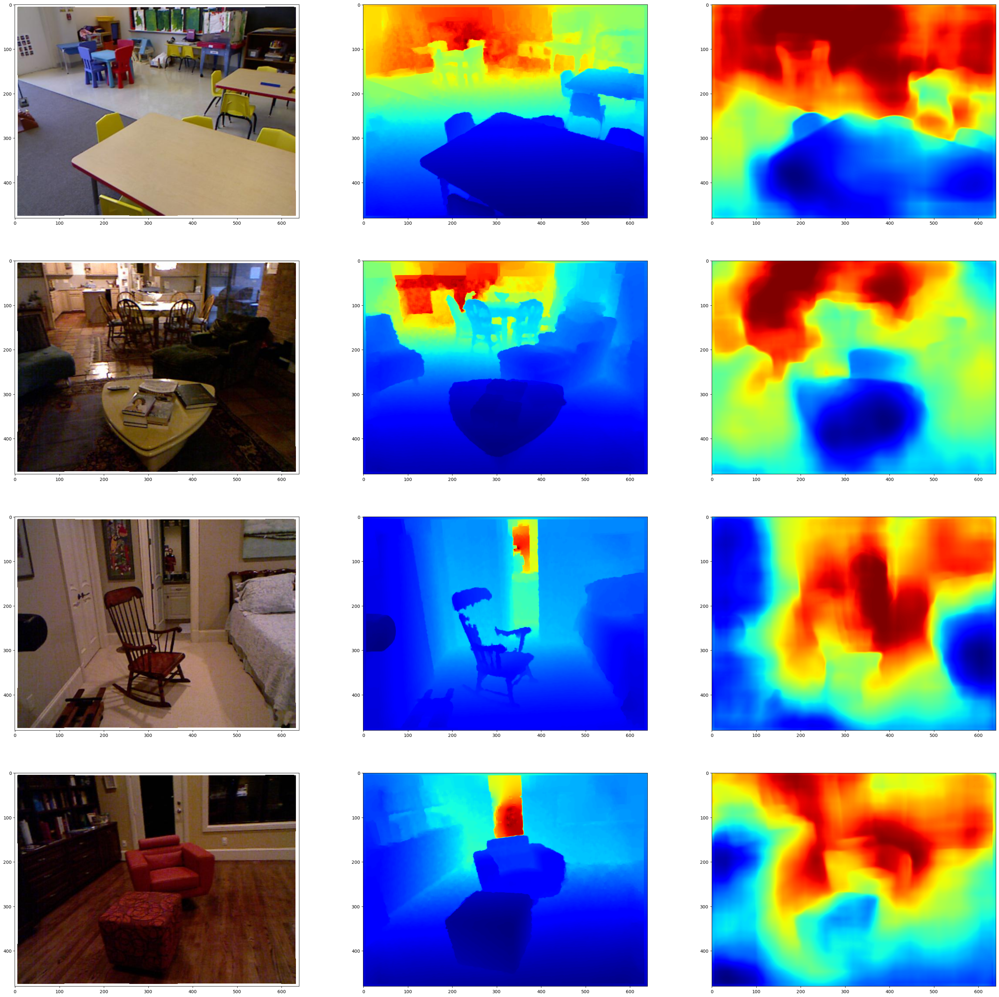

In [ ]:
visualize_depth_map(x, y, model)

Set all the layers as trainable and finetune the model

In [ ]:
for layer in model.layers:
  layer.trainable = True

In [ ]:
optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0001,
    amsgrad=True,
)

model.compile(optimizer, loss=depth_loss_function)

In [ ]:
epochs = 30
history = model.fit(train_generator, validation_data=val_generator, steps_per_epoch=len(x_train) // batch_size, epochs=epochs, validation_steps=20)

Epoch 1/30
262/262 [==============================] - 223s 788ms/step - loss: 0.2223 - val_loss: 0.2025
Epoch 2/30
262/262 [==============================] - 205s 783ms/step - loss: 0.1919 - val_loss: 0.1843
Epoch 3/30
262/262 [==============================] - 203s 774ms/step - loss: 0.1729 - val_loss: 0.2158
Epoch 4/30
262/262 [==============================] - 203s 776ms/step - loss: 0.1582 - val_loss: 0.1837
Epoch 5/30
262/262 [==============================] - 197s 754ms/step - loss: 0.1569 - val_loss: 0.1743
Epoch 6/30
262/262 [==============================] - 205s 782ms/step - loss: 0.1477 - val_loss: 0.1958
Epoch 7/30
262/262 [==============================] - 202s 770ms/step - loss: 0.1436 - val_loss: 0.1724
Epoch 8/30
262/262 [==============================] - 201s 768ms/step - loss: 0.1432 - val_loss: 0.1893
Epoch 9/30
262/262 [==============================] - 201s 767ms/step - loss: 0.1408 - val_loss: 0.1943
Epoch 10/30
262/262 [==============================] - 204s 778m

In [ ]:
model.save_weights("dense+encoder+skip30_f30.h5")

In [ ]:
model.load_weights("dense+encoder+skip30_f30.h5")

### evaluation

In [ ]:
def compute_errors(gt, pred):
    thresh = np.maximum((gt / pred), (pred / gt))
    a1 = (thresh < 1.25   ).mean()
    a2 = (thresh < 1.25 ** 2).mean()
    a3 = (thresh < 1.25 ** 3).mean()
    abs_rel = np.mean(np.abs(gt - pred) / gt)
    rmse = (gt - pred) ** 2
    rmse = np.sqrt(rmse.mean())
    log_10 = (np.abs(np.log10(gt)-np.log10(pred))).mean()
    return a1, a2, a3, abs_rel, rmse, log_10

pred = model.predict(np.array(x_test)).squeeze()

print(compute_errors(np.array(y_test)*4.0, pred))

7/7 [==============================] - 36s 2s/step
(0.7137663899739584, 0.9184179850260417, 0.9812176920572917, 0.18016508, 0.84727854, 0.07694755)


### demo (best)

(4, 480, 640, 3)
(4, 480, 640)
1/1 [==============================] - 0s 47ms/step


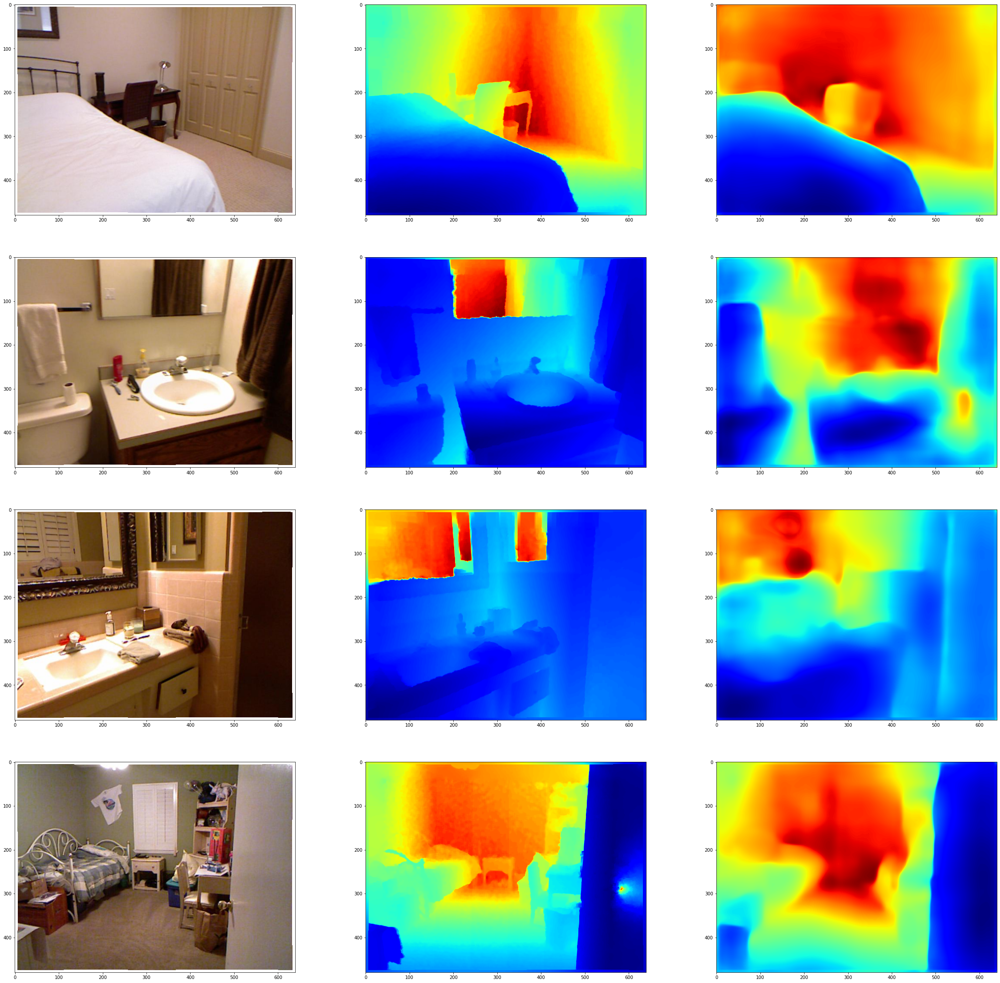

In [ ]:
def visualize_depth_map(x, y, model=None):
    input = x
    target = y
    cmap = plt.cm.jet
    cmap.set_bad(color="black")

    num_samples = len(x)
    pred = model.predict(input)
    fig, ax = plt.subplots(num_samples, 3, figsize=(40, 10*num_samples))
    for i in range(num_samples):
        ax[i, 0].imshow((input[i].squeeze()))
        ax[i, 1].imshow((target[i].squeeze()*4), cmap=cmap)
        ax[i, 2].imshow((pred[i].squeeze()), cmap=cmap)
x, y = next(test_generator)
print(x.shape)
print(y.shape)
visualize_depth_map(x, y, model)

1/1 [==============================] - 0s 52ms/step


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("jet").copy()
  """


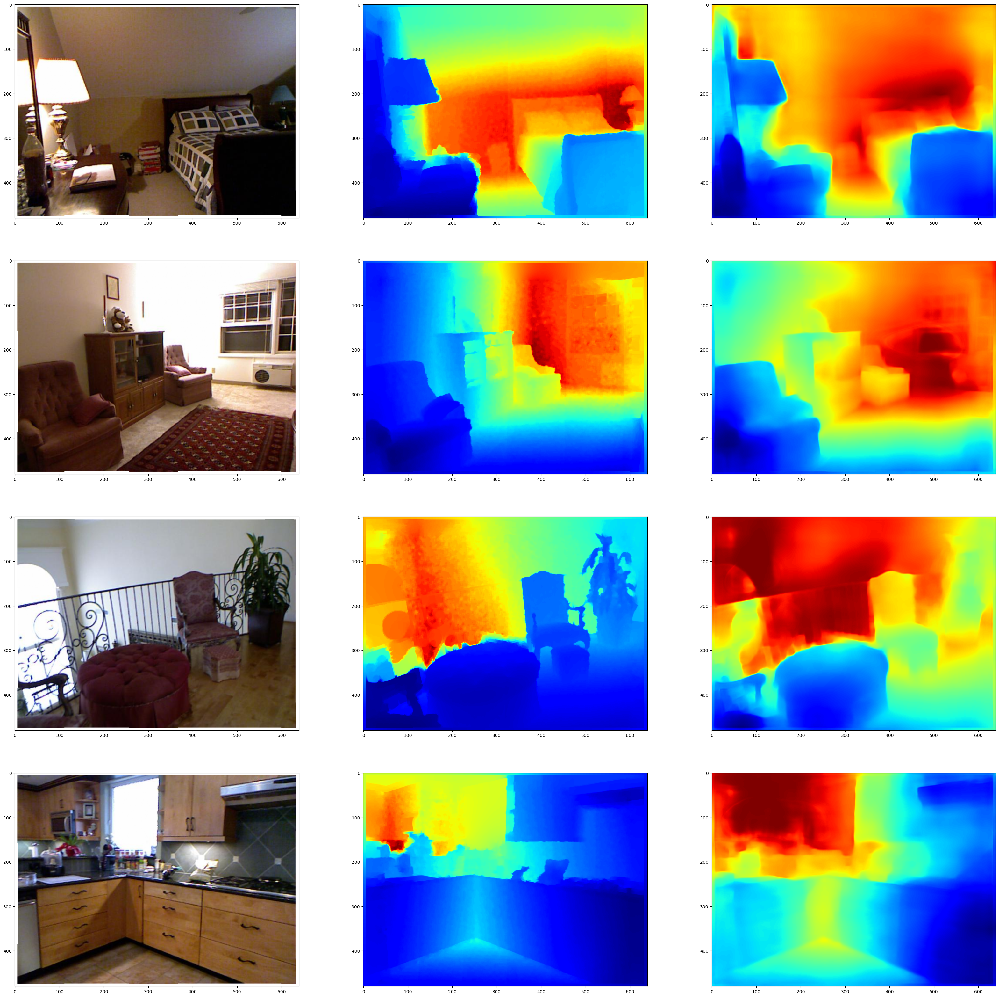

In [ ]:
x, y = next(test_generator)
visualize_depth_map(x, y, model)

1/1 [==============================] - 0s 141ms/step


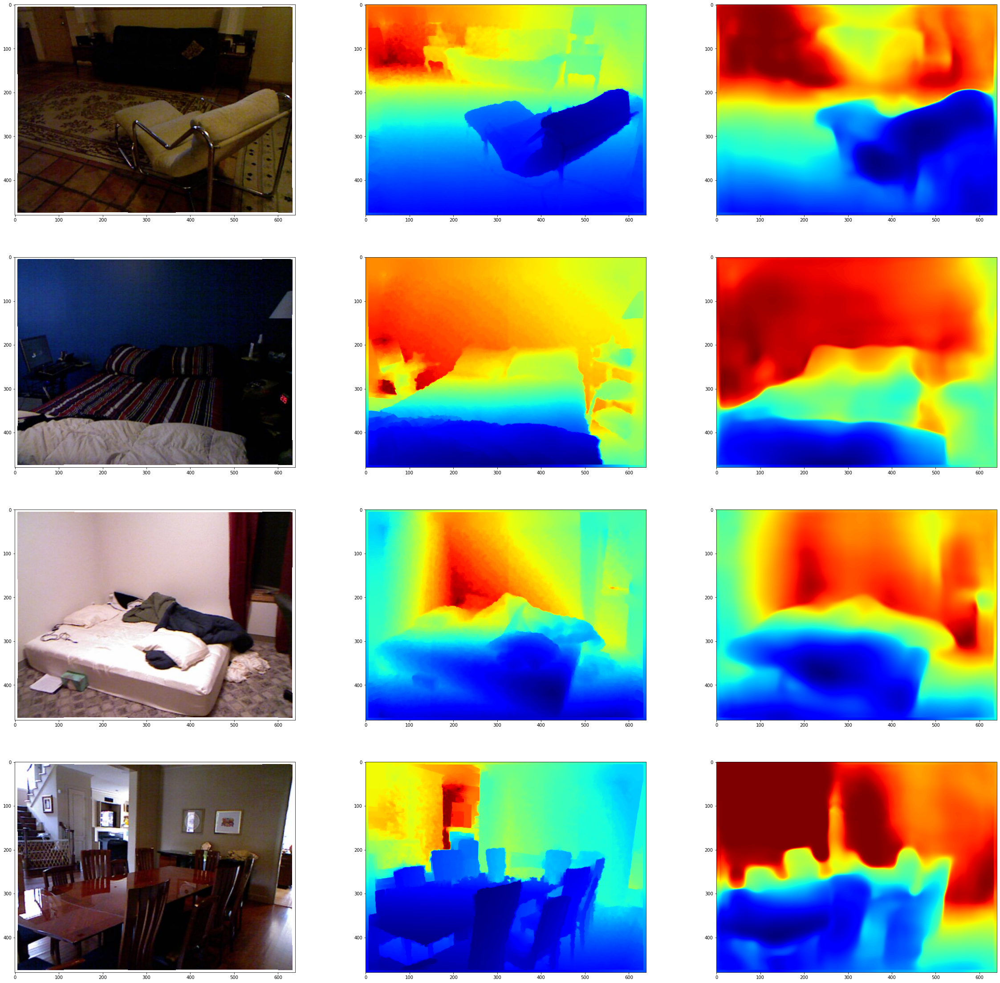

In [ ]:
x, y = next(test_generator)
visualize_depth_map(x, y, model)

1/1 [==============================] - 0s 44ms/step


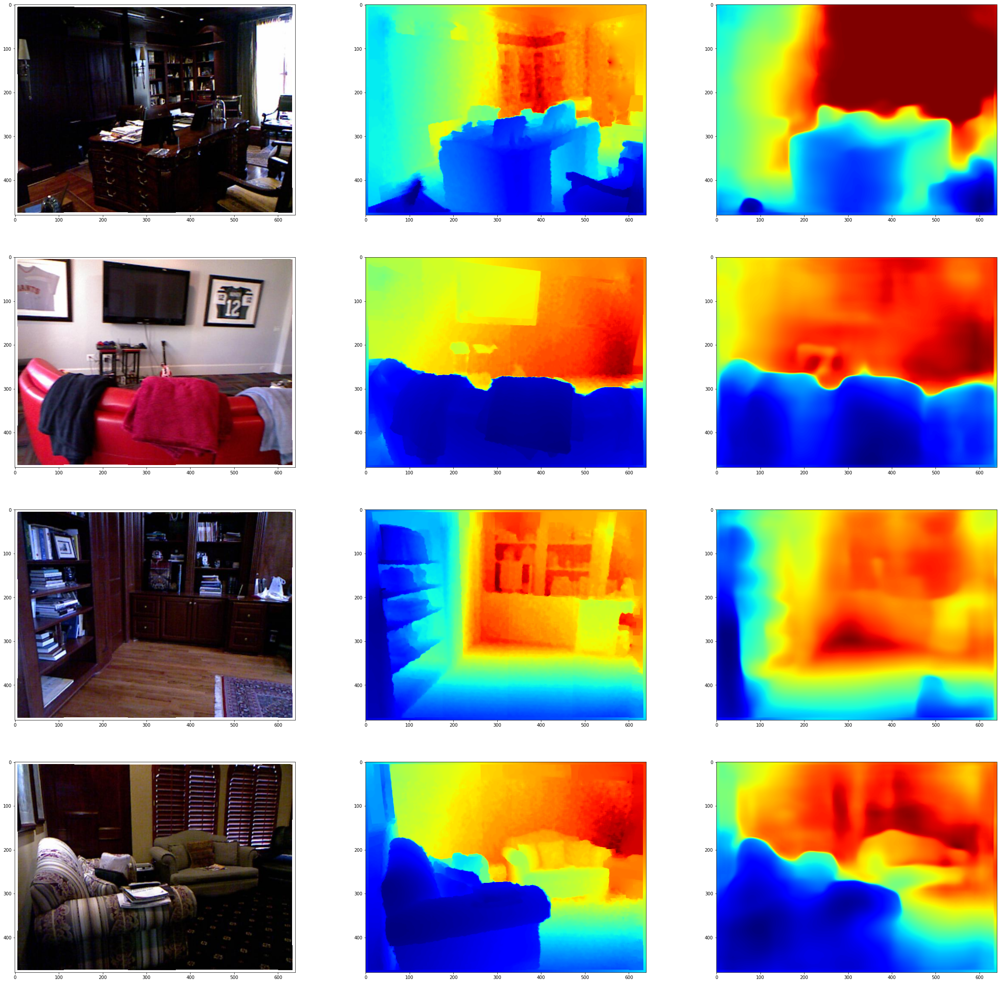

In [ ]:
x, y = next(test_generator)
visualize_depth_map(x, y, model)